# Generalized Localization 3D

## Includes

In [1]:
using Interpolations
using Random
using Plots
using Statistics
include("localization3d.jl")
include("../src/relevant_slepian_alpha.jl")

get_quadrature_nodes_2D (generic function with 3 methods)

## Helper Functions

### Making the shape

In [2]:
function smoothstep(t)
    return t * t * (3 - 2 * t)
end

function lerp(a, b, t)
    return a + t * (b - a)
end

function grad(hash, x, y, z)
    h = hash & 15
    u = ifelse(h < 8, x, y)
    v = ifelse(h < 4, y, ifelse(h == 12 || h == 14, x, z))
    return ifelse((h & 1) == 0, u, -u) + ifelse((h & 2) == 0, v, -v)
end

grad (generic function with 1 method)

### Adding Noise

In [3]:
function noise(x, y, z)
    # Compute grid cell coordinates
    X = (floor(Int, x) & 255) + 1
    Y = (floor(Int, y) & 255) + 1
    Z = (floor(Int, z) & 255) + 1
    
    # Relative coordinates within grid cell
    x -= floor(x)
    y -= floor(y)
    z -= floor(z)
    
    # Compute fade curves for x, y, z
    u = smoothstep(x)
    v = smoothstep(y)
    w = smoothstep(z)
    
    # Hash coordinates of the cube corners
    A  = perm[X] + Y
    AA = perm[A] + Z
    AB = perm[A + 1] + Z
    B  = perm[X + 1] + Y
    BA = perm[B] + Z
    BB = perm[B + 1] + Z
    
    # Add blended results from the 8 corners of the cube
    return lerp(
        lerp(
            lerp(grad(perm[AA], x, y, z), grad(perm[BA], x - 1, y, z), u),
            lerp(grad(perm[AB], x, y - 1, z), grad(perm[BB], x - 1, y - 1, z), u),
            v
        ),
        lerp(
            lerp(grad(perm[AA + 1], x, y, z - 1), grad(perm[BA + 1], x - 1, y, z - 1), u),
            lerp(grad(perm[AB + 1], x, y - 1, z - 1), grad(perm[BB + 1], x - 1, y - 1, z - 1), u),
            v
        ),
        w
    )
end

noise (generic function with 1 method)

### Interpolation

In [4]:
function cubic_interpolate(p, x)
    # Cubic interpolation
    return p[2] + 0.5 * x * (p[3] - p[1] + x * (2.0 * p[1] - 5.0 * p[2] + 4.0 * p[3] - p[4] + x * (3.0 * (p[2] - p[3]) + p[4] - p[1])))
end

function interpolate_2d(grid, x, y)
    # Ensure x and y are within bounds
    nx, ny = size(grid)
    x = clamp(x, 1.0, nx - 2.0)
    y = clamp(y, 1.0, ny - 2.0)
    
    # Get integer and fractional parts of x and y
    x0, dx = floor(Int, x), x - floor(x)
    y0, dy = floor(Int, y), y - floor(y)
    
    # Extract a 4x4 patch around (x0, y0)
    patch = grid[max(1, x0 - 1):min(nx, x0 + 2), max(1, y0 - 1):min(ny, y0 + 2)]
    
    # Pad patch to ensure it's 4x4 (needed for cubic interpolation at boundaries)
    padded_patch = zeros(4, 4)
    padded_patch[1:size(patch, 1), 1:size(patch, 2)] .= patch
    
    # Interpolate along x for each of the four rows
    col_interp = [cubic_interpolate(padded_patch[:, i], dx) for i in 1:4]
    
    # Interpolate along y
    return cubic_interpolate(col_interp, dy)
end

interpolate_2d (generic function with 1 method)

### Generating the Random Shape

In [5]:
function randSphere(; xm=0.0, ym=0.0, zm=0.0, r=1.0, dr=0.2, Nθ=100, Nφ=50)
    # Create grids for θ and φ
    θ = LinRange(0, 2π, Nθ)
    φ = LinRange(0, π, Nφ)
    
    # Generate noise-based perturbations
    perturbations = [r + dr * noise(θ_i / (2π), φ_j / π, 0.0) for θ_i in θ, φ_j in φ]
    
    # Fine grid for smooth sphere
    fine_θ = LinRange(0, 2π, Nθ * 10)
    fine_φ = LinRange(0, π, Nφ * 10)
    
    xs = []
    ys = []
    zs = []
    
    for φ_val in fine_φ
        for θ_val in fine_θ
            # Map θ and φ to grid indices
            θ_idx = (θ_val / (2π)) * (Nθ - 1) + 1
            φ_idx = (φ_val / π) * (Nφ - 1) + 1
            
            # Interpolate the radius
            radius = interpolate_2d(perturbations, θ_idx, φ_idx)
            
            # Convert to Cartesian coordinates
            push!(xs, xm + radius * sin(φ_val) * cos(θ_val))
            push!(ys, ym + radius * sin(φ_val) * sin(θ_val))
            push!(zs, zm + radius * cos(φ_val))
        end
    end
    
    return xs, ys, zs
end

randSphere (generic function with 1 method)

## Analysis

In [6]:
const perm = randperm(256)  # Create a fixed permutation array

256-element Vector{Int64}:
  11
  28
 175
 148
 181
 114
 218
  82
 244
  65
 119
 187
 211
   ⋮
  98
  26
 177
 220
 164
 125
  61
 158
 101
 246
  35
  38

In [7]:
# Creating a random perturbed sphere
xs, ys, zs = randSphere(xm=0.0, ym=0.0, zm=0.0, r=1.0, dr=0.4, Nθ=15, Nφ=50)

(Any[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0  …  1.0360191447376159e-16, 1.0525182431429648e-16, 1.0671460025215607e-16, 1.0798764152510389e-16, 1.0906868471221374e-16, 1.0995580775814944e-16, 1.1064743339050912e-16, 1.1114233192415796e-16, 1.1143962344756344e-16, 1.1153877938724601e-16], Any[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0  …  -4.132242278192465e-17, -3.6918190444673796e-17, -3.244831891206797e-17, -2.7920755452573186e-17, -2.3343549908796024e-17, -1.8724840385157337e-17, -1.4072838778639654e-17, -9.395816178333644e-18, -4.702088159744231e-18, -2.731912183147872e-32], Any[0.9659477230870589, 0.9660186691760344, 0.9716255773183479, 0.9805752468503355, 0.9906744771083329, 0.9997300674286763, 1.0055488171477014, 1.005937525601744, 0.9987029921271404, 0.9816520160602262  …  -0.9107832516681842, -0.9107832516681842, -0.9107832516681842, -0.9107832516681842, -0.9107832516681842, -0.9107832516681842, -0.9107832516681842, -0.9107832516681842, -0.9107832516681842, -0.

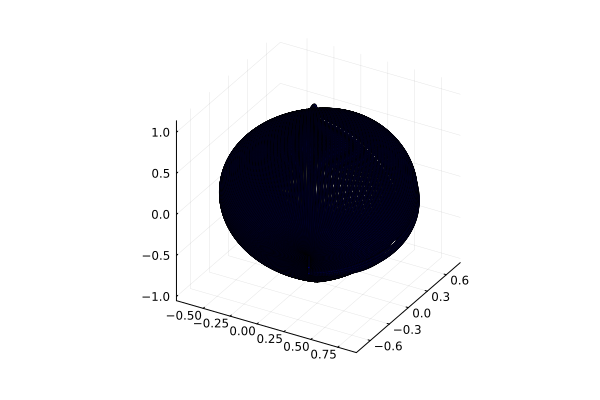

In [21]:
scatter3d(xs, ys, zs, marker = (:circle, 1), color = :blue, label=false)

### Making Layers

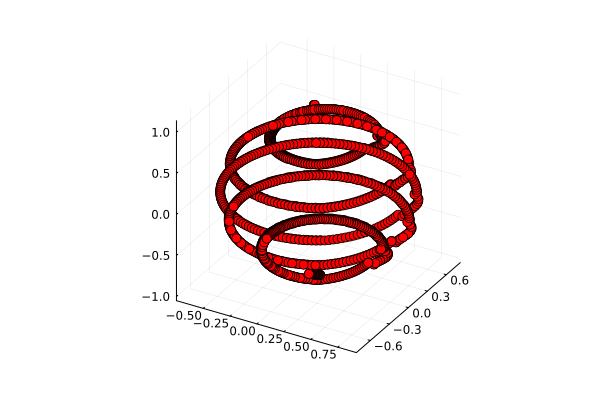

In [9]:
Nz = 7
min_z = minimum(zs)
max_z = maximum(zs)
z_pieces = collect(range(min_z, max_z; length=Nz))  # z intervals
tolerance = 0.005
filtered_points = [(x, y, z) for (x, y, z) in zip(xs, ys, zs) if any(abs(z - z_piece) <= tolerance for z_piece in z_pieces)]
fxs, fys, fzs = map(v -> [p[v] for p in filtered_points], (1, 2, 3))
scatter3d(fxs, fys, fzs, marker = (:circle, 5), color = :red, label=false)

### Plotting the ith layer

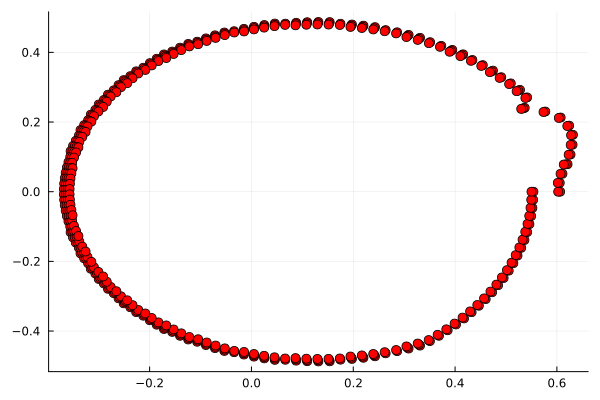

In [10]:
i = 2
z_piece = z_pieces[i]
# Filter points close to the current z_piece
filtered_points2 = [(x, y, z) for (x, y, z) in zip(xs, ys, zs) if abs(z - z_piece) <= tolerance]

# Extract x, y, z components
fxs2, fys2, _ = map(v -> [p[v] for p in filtered_points2], (1, 2, 3))

# Create scatter plot for the current piece
scatter(
    fxs2, fys2, 
    marker = (:circle, 5), 
    color = :red, 
    label = false,
)


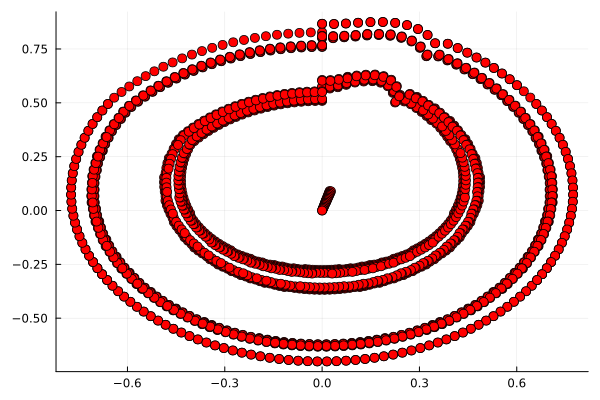

In [11]:
scatter(fys, fxs, marker = (:circle, 5), color = :red, label=false)

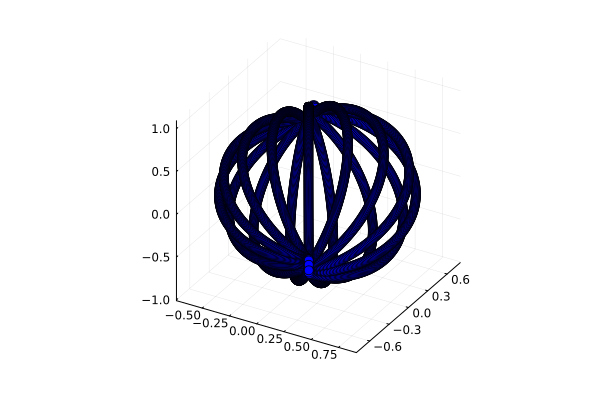

In [12]:
#Sanity check
n = 20

# Select every nth element
xs_nth = xs[1:n:end]
ys_nth = ys[1:n:end]
zs_nth = zs[1:n:end]

# Plot every nth element
scatter3d(xs_nth, ys_nth, zs_nth, marker = (:circle, 5), color = :blue, label=false)

### Contouring

Vector{Float64}

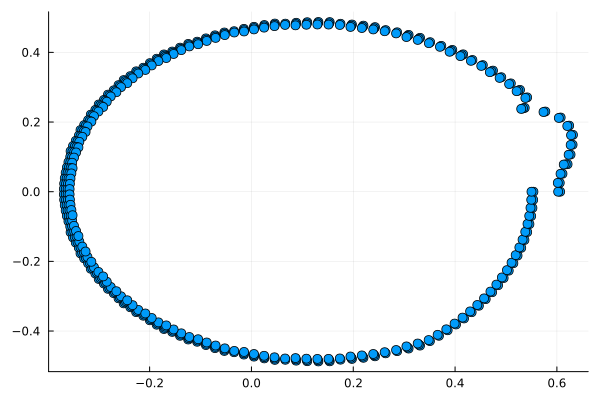

In [13]:
xx = []
yy = []
zz = collect(-((Nz-1)/2):((Nz-1)/2))

for z_piece in z_pieces
    group_points = [(x, y, z) for (x, y, z) in zip(xs, ys, zs) if abs(z - z_piece) <= tolerance]
    push!(xx, [p[1] for p in group_points])
    push!(yy, [p[2] for p in group_points])
end
print(typeof(xx[i]))
scatter(xx[i], yy[i], marker = (:circle, 5), label=false)

### Spline

7(1925, 3)


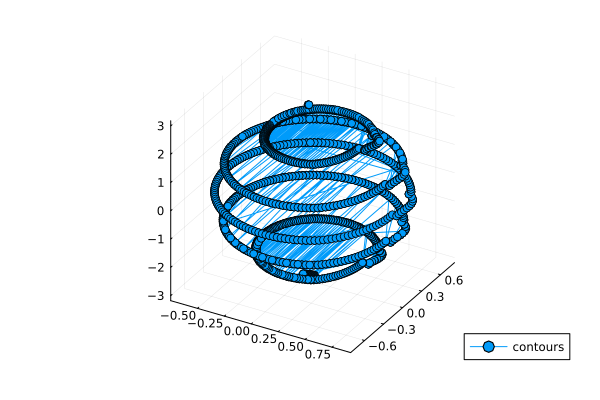

In [14]:
Nz = size(xx)[1]
print(Nz)
# z, y, x is the order
thpha = map(a -> hcat(ones(length(yy[a]))*zz[a], yy[a], xx[a]), 1:Nz)
#thpha = map(a -> hcat(ones(length(yy))*zz[a], (1.1-abs(zz[a]))*yy, (1.1-abs(zz[a]))*xx), 1:Nz)

# ind = vcat(collect(1:2:100), 100)

# Shorten the second closed curve
# thpha[2] = hcat(thpha[2][ind, 1], thpha[2][ind, 2], thpha[2][ind, 3])

thph = vcat(thpha...)
println(size(thph))

# This is necessary to close the curve
#thph = vcat(thph, thph[1,:]')

p = plot(thph[:,3], thph[:,2], thph[:,1], label = "contours", marker = :o)

In [15]:
#spline
N = 100
thpha_new = equalNclosedcurve(thpha, N);

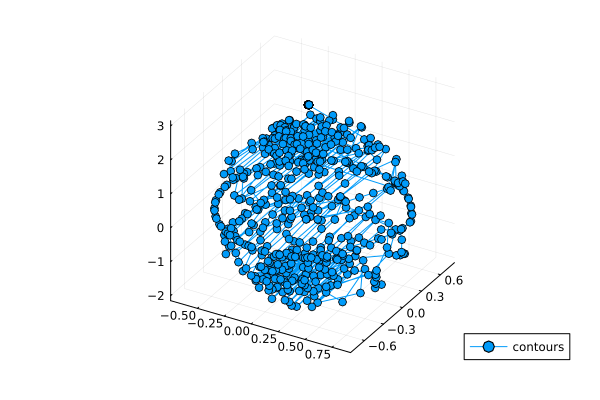

In [16]:
thph_new = vcat(thpha_new...)
p = plot(thph_new[:,3], thph_new[:,2], thph_new[:,1], label = "contours", marker = :o)

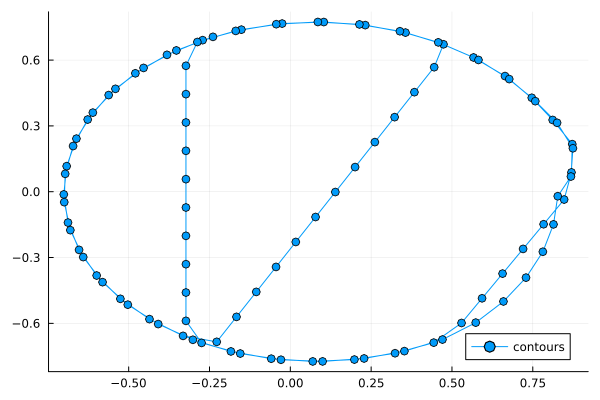

In [17]:
a = 3
p = plot(thpha_new[a][:,3], thpha_new[a][:,2], label = "contours", marker = :o)

In [18]:
Nqx = Nqy = 16
Nqz = 10

# set parameters for the integration

M  = 3
Kp = [4.0]
szs = int = (Nqx, Nqy, Nqz)
prec = 1e-8
exact = false
lvl = 6
maxrank = 256

256

In [19]:
z = [-2,-1,0,1,2,3]
colf, th, wqz = scale_quad_nodez(Nqz, z)

([1, 1, 1, 2, 3, 3, 4, 5, 5, 5], [-1.9347663212929294, -1.6626584167224614, -1.198523920747561, -0.5834884853231181, 0.127814152545922, 0.872185847454078, 1.5834884853231181, 2.198523920747561, 2.6626584167224614, 2.9347663212929294], [0.16667836077172052, 0.3736283728764514, 0.5477159062899551, 0.6731667982749913, 0.7388105617868823, 0.7388105617868823, 0.6731667982749913, 0.5477159062899551, 0.3736283728764514, 0.16667836077172052])

In [20]:
newcurve, pkg = fill2d(z, colf, thpha_new, th, Nqx, Nqy)

LoadError: UndefVarError: `interpcontour` not defined in `Main`
Suggestion: check for spelling errors or missing imports.